# Tutorial 3: Marker dynamics using the P1-Mono dataset

In this tutorial we plot the evolution of each CD marker as a function of the TimeFlow-inferred pseudotime using the P1-Mono dataset.

In [1]:
from __future__ import division
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pygam import LinearGAM, s

In [2]:
# Retrieve results computed in Tutorial-2
P1_mono_results = pd.read_csv("./Results-P1-Monocytes/P1_monocytes_pseudotime.csv")

In [4]:
df = P1_mono_results.copy()
df = df.sort_values('pseudotime')

# Scale pseudotime to [0,1]
column = 'pseudotime'
df[column] = (df[column] - df[column].min()) / (df[column].max() - df[column].min())

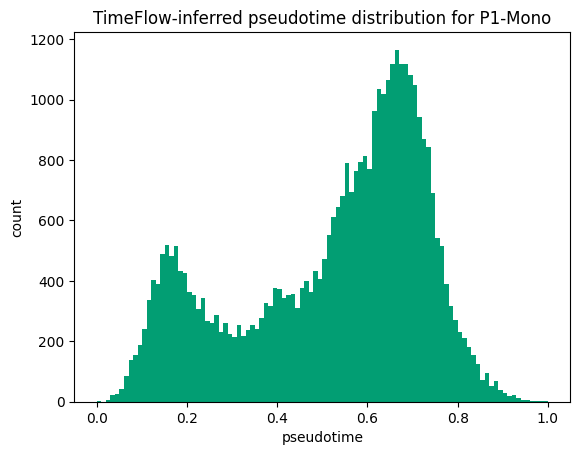

In [5]:
# Plot the TimeFlow pseudotime distribution
plt.hist(df.pseudotime, bins=100, color="#029e73")
plt.title("TimeFlow-inferred pseudotime distribution for P1-Mono")
plt.xlabel("pseudotime")
plt.ylabel("count")
plt.show()

In [6]:
Monocells = ["m1","m2","m3"]
df_mono = df[df.Celltype.isin(Monocells)]

# Change label names
df_mono = df_mono.replace({'Celltype': "m1"}, "Immat")
df_mono = df_mono.replace({'Celltype': "m2"}, "Interm")
df_mono = df_mono.replace({'Celltype': "m3"}, "Mat")

Fit GAM models and visualize the evolution of the CD markers along pseudotime. In the following scatterplots, each dot represents a cell, colored by its known maturation stage. Note, that the labels were not used during pseudotime computation.

In [7]:
sns.set(style="white", font_scale=2)

palette_monocytes = {'Immat': '#0173b2', 'Interm': '#ece133', "Mat": "#029e73"}

columns_to_plot = df_mono.columns[:20]
pseudotime_col = "pseudotime"

fig, axs = plt.subplots(nrows=7, ncols=3, figsize=(21, 49), dpi=250)
fig.subplots_adjust(hspace=0.5, wspace=0.5)

for idx, (col, ax) in enumerate(zip(columns_to_plot, axs.flatten())):
    sns.scatterplot(
        x=pseudotime_col,
        y=col,
        data=df_mono,
        hue="Celltype",
        edgecolor="none",
        palette=palette_monocytes,
        s=5,
        ax=ax
    )
    ax.set_title(f'P1-Mono - {col}')

    if idx % 3 == 0: 
        ax.legend(fontsize='medium', markerscale=5)
    else:
        ax.legend([],[], frameon=False)  

    gam = LinearGAM(s(0, spline_order=3)).fit(df_mono[pseudotime_col], df_mono[col])
    XX = np.linspace(df_mono[pseudotime_col].min(), df_mono[pseudotime_col].max(), 1000)
    
    ax.plot(XX, gam.predict(XX), color='black')

for i in range(len(columns_to_plot), len(axs.flatten())):
    axs.flatten()[i].axis('off')

plt.tight_layout()
plt.show()